In [1]:
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# STEP 1: Basic update equations
# STEP 2: Periodic boundary conditions
# STEP 3: Incorporate a PML
# STEP 4: Total-Field/Scattered-Field
# STEP 5: Calculate TRN, REF, and CON
# STEP 6: Model a Device to Benchmark

In [3]:
# compute CEx
Nx = 100
Ny = 100
Ez = [[0.0 for x in range(Nx)] for y in range(Ny)]
dy = 1
CEx = [[0.0 for x in range(Nx)] for y in range(Ny)]
for nx in range(Nx):
    for ny in range(Ny - 1):
        CEx[nx][ny] = (Ez[nx][ny + 1] - Ez[nx][ny]) / dy
    CEx[nx][Ny - 1] = (0 - Ez[nx][Ny - 1]) / dy


In [4]:
# compute CEx and CEy, use np.zeros
Nx = 100
Ny = 100
Ez = np.zeros((Nx, Ny))
CEx = np.zeros((Nx, Ny))
CEy = np.zeros((Nx, Ny))
dy = dx = 1
for nx in range(Nx):
    for ny in range(Ny - 1):
        CEx[nx][ny] = (Ez[nx][ny + 1] - Ez[nx][ny]) / dy
    CEx[nx][Ny - 1] = (0 - Ez[nx][Ny - 1]) / dy

for ny in range(Ny):
    for nx in range(Nx - 1):
        CEy[nx][ny] = -(Ez[nx + 1][ny] - Ez[nx][ny]) / dx
    CEy[Nx - 1][ny] = -(0 - Ez[Nx - 1][ny]) / dx

In [5]:
# compute CHz
CHz = np.zeros((Nx, Ny))
Hy = np.zeros((Nx, Ny))
Hx = np.zeros((Nx, Ny))

CHz[0][0] = ((Hy[0][0] - 0) / dx 
          -  (Hx[0][0] - 0) / dy)
for nx in range(1, Nx):
    CHz[nx][0] = ((Hy[nx][0] - Hy[nx - 1][0]) / dx 
               -  (Hx[nx][0] - 0) / dy)

for ny in range(1, Ny):
    CHz[0][ny] = ((Hy[0][ny] - 0) / dx 
               -  (Hx[0][ny] - Hx[0][ny - 1]) / dy)
    for nx in range(1, Nx):
        CHz[nx][ny] = ((Hy[nx][ny] - Hy[nx - 1][ny]) / dx 
                    -  (Hx[nx][ny] - Hx[nx][ny - 1]) / dy)
    

In [6]:
Nx = 61
Ny = 61
Ez = np.zeros((Nx, Ny))
Dz = np.zeros((Nx, Ny))
Hy = np.zeros((Nx, Ny))
Hx = np.zeros((Nx, Ny))
CEx = np.zeros((Nx, Ny))
CEy = np.zeros((Nx, Ny))
CHz = np.zeros((Nx, Ny))
ICEx = np.zeros((Nx, Ny))
ICEy = np.zeros((Nx, Ny))
IDz = np.zeros((Nx, Ny))

# Coeffs
e0 = 8.8542e-12
dt = 1.6678e-10
c0 = 299792458
u0 = 1 / e0 / c0**2
dx = dt * c0 * 2
dy = dt * c0 * 2
# Compute PML Parameters
Nx2 = 2 * Nx
Ny2 = 2 * Ny

NN = 20
NPML = [NN] * 4
xx = np.array(range(Nx))
yy = np.array(range(Ny))
xx2 = np.array(range(NN - 1, Nx - NN))
yy2 = np.array(range(NN - 1, Nx - NN))

sigx = np.zeros((Nx2, Ny2))
for nx in range(2 * NPML[0]):
    nx1 = 2 * NPML[0] - nx - 1
    sigx[nx1, :] = (0.5 * e0 / dt) * (nx/2/NPML[0])**3
    
for nx in range(2 * NPML[1]):
    nx1 = Nx2 - 2 * NPML[1] + nx
    sigx[nx1, :] = (0.5 * e0 / dt) * (nx/2/NPML[1])**3

sigy = np.zeros((Nx2, Ny2))
for ny in range(2 * NPML[2]):
    ny1 = 2 * NPML[2] - ny - 1
    sigy[:, ny1] = (0.5 * e0 / dt) * (ny/2/NPML[0])**3
    
for ny in range(2 * NPML[3]):
    ny1 = Ny2 - 2 * NPML[3] + ny
    sigy[:, ny1] = (0.5 * e0 / dt) * (ny/2/NPML[1])**3

sigx = np.zeros((Nx2, Ny2))
sigy = np.zeros((Nx2, Ny2))



In [7]:
# COMPUTE UPDATE COEFFICIENTS
URxx = np.ones((Nx, Ny))
URyy = np.ones((Nx, Ny))
ERzz = np.ones((Nx, Ny))
sigHx = sigx[0::2, 1::2] # slicing 
sigHy = sigy[0::2, 1::2]
mHx0 = (1./dt) + sigHy/(2.*e0)
mHx1 = ((1./dt) - sigHy/(2.*e0))/mHx0
mHx2 = - c0 / URxx / mHx0
mHx3 = -(c0 * dt/e0) * sigHx / URxx / mHx0

sigHx = sigx[1::2, 0::2]
sigHy = sigy[1::2, 0::2]
mHy0 = (1./dt) + sigHx/(2.*e0)
mHy1 = ((1./dt) - sigHx/(2.*e0)) / mHy0
mHy2 = - c0 / URyy / mHy0
mHy3 = -(c0*dt/e0) * sigHy / URyy / mHy0

sigDx = sigx[::2, ::2]
sigDy = sigy[::2, ::2]
mDz0 = (1./dt) + (sigDx + sigDy) / (2.*e0) \
     + sigDx * sigDy * (dt / 4. / e0**2)
mDz1 = (1./dt) - (sigDx + sigDy) / (2*e0) \
     - sigDx * sigDy * (dt / 4. / e0**2)
mDz1 = mDz1 / mDz0
mDz2 = c0 / mDz0
mDz4 = -(dt/e0**2) * sigDx * sigDy / mDz0

# 
ap = (sigHx + sigHy) * 1e+3 * 1.5

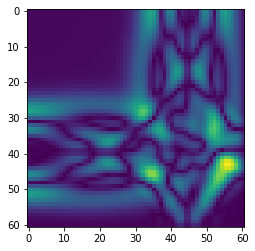

In [8]:
# source
Nt = 200
tt = np.array(range(Nt))
tau = 6
gEz = np.exp(- ((tt - 50)/tau)**2)
xsrc = int(np.ceil(Nx / 3))
ysrc = int(np.ceil(Ny / 4))

fig = plt.figure()
plts = []
for nt in range(Nt):
    # COMPUTE CURL PART OF +EZ/dy
    for nx in range(Nx):
        for ny in range(Ny - 1):
            CEx[nx][ny] = (Ez[nx][ny + 1] - Ez[nx][ny]) / dy
        CEx[nx][Ny - 1] = (0.0 - Ez[nx][Ny - 1]) / dy
        
    # COMPUTE CURLD PART OF -EZ/dx
    for ny in range(Ny):
        for nx in range(Nx - 1):
            CEy[nx][ny] = -(Ez[nx + 1][ny] - Ez[nx][ny]) / dx
        CEy[Nx - 1][ny] = -(0.0 - Ez[Nx - 1][ny]) / dx
        
    # UPDATE H INTEGRATIONS
    ICEx = ICEx + CEx
    ICEy = ICEy + CEy
    
    # UPDATE Hx/Hy FIELDS
    Hx = mHx1 * Hx + mHx2 * CEx + mHx3 * ICEx
    Hy = mHy1 * Hy + mHy2 * CEy + mHy3 * ICEy
    
    # COMPUTE CURL PART Hy/dx - Hx/dy
    CHz[0][0] = ((Hy[0][0] - 0.0) / dx 
              -  (Hx[0][0] - 0.0) / dy)
    for nx in range(1, Nx):
        CHz[nx][0] = ((Hy[nx][0] - Hy[nx - 1][0]) / dx 
                   -  (Hx[nx][0] - 0.0) / dy)

    for ny in range(1, Ny):
        CHz[0][ny] = ((Hy[0][ny] - 0.0) / dx 
                   -  (Hx[0][ny] - Hx[0][ny - 1]) / dy)
        for nx in range(1, Nx):
            CHz[nx][ny] = ((Hy[nx][ny] - Hy[nx - 1][ny]) / dx 
                        -  (Hx[nx][ny] - Hx[nx][ny - 1]) / dy)
    # UPDATE D INTEGRAL
    IDz = IDz + Dz
    # UPDATE D FIELD
    Dz = mDz1 * Dz + mDz2 * CHz + mDz4 * IDz
    # ADD GAUSSIAN SOURCE
    Dz[xsrc][ysrc] = Dz[xsrc][ysrc] + gEz[nt]
    # UPDATE Ez FIELD
    Ez = (1. / ERzz) * Dz
    Ezmax = max(max(map(max, abs(Ez))), 0.01)
    p = plt.imshow(abs(Ez), vmax = Ezmax)
    plts.append([p])
    
from matplotlib import animation
ani = animation.ArtistAnimation(fig, plts, interval = 50, repeat_delay = 3000)
ani.save('wave2d.gif', writer='ffmpeg')
plt.show()

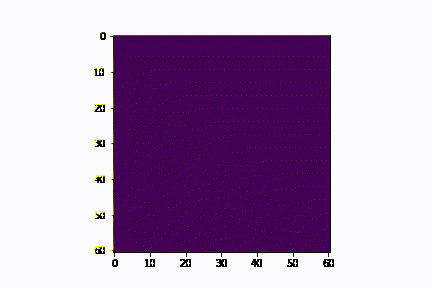

In [9]:
from IPython.display import Image
with open('wave2d.gif','rb') as file:
    display(Image(file.read()))

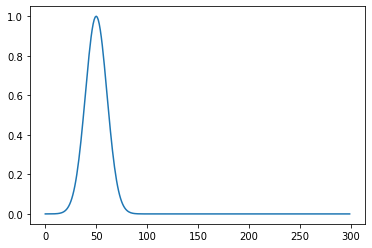

In [11]:
# SOURCE
Nt = 300
tt = np.array(range(Nt))
tau = 15
gEz = np.exp(- ((tt - 50)/tau)**2)
fig = plt.figure()
plt.plot(gEz)

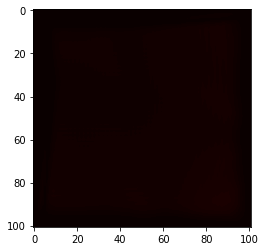

In [12]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

Nx = 101
Ny = 101
Ez = np.zeros((Nx, Ny))
Dz = np.zeros((Nx, Ny))
Hy = np.zeros((Nx, Ny))
Hx = np.zeros((Nx, Ny))
CEx = np.zeros((Nx, Ny))
CEy = np.zeros((Nx, Ny))
CHz = np.zeros((Nx, Ny))
ICEx = np.zeros((Nx, Ny))
ICEy = np.zeros((Nx, Ny))
IDz = np.zeros((Nx, Ny))

# Coeffs
e0 = 8.8542e-12
dt = 1.6678e-10
c0 = 299792458
u0 = 1 / e0 / c0**2
dx = dt * c0 * 2
dy = dt * c0 * 2
# Compute PML Parameters
Nx2 = 2 * Nx
Ny2 = 2 * Ny

NN = 20
NPML = [NN] * 4
xx = np.array(range(Nx))
yy = np.array(range(Ny))
xx2 = np.array(range(NN - 1, Nx - NN))
yy2 = np.array(range(NN - 1, Nx - NN))

sigx = np.zeros((Nx2, Ny2))
for nx in range(2 * NPML[0]):
    nx1 = 2 * NPML[0] - nx - 1
    sigx[nx1, :] = (0.5 * e0 / dt) * (nx/2/NPML[0])**3
    
for nx in range(2 * NPML[1]):
    nx1 = Nx2 - 2 * NPML[1] + nx
    sigx[nx1, :] = (0.5 * e0 / dt) * (nx/2/NPML[1])**3

sigy = np.zeros((Nx2, Ny2))
for ny in range(2 * NPML[2]):
    ny1 = 2 * NPML[2] - ny - 1
    sigy[:, ny1] = (0.5 * e0 / dt) * (ny/2/NPML[0])**3
    
for ny in range(2 * NPML[3]):
    ny1 = Ny2 - 2 * NPML[3] + ny
    sigy[:, ny1] = (0.5 * e0 / dt) * (ny/2/NPML[1])**3
# set these to remove PML
# sigx = np.zeros((Nx2, Ny2))
# sigy = np.zeros((Nx2, Ny2))

# COMPUTE UPDATE COEFFICIENTS
URxx = np.ones((Nx, Ny))
URyy = np.ones((Nx, Ny))
ERzz = np.ones((Nx, Ny))
sigHx = sigx[0::2, 1::2] # slicing 
sigHy = sigy[0::2, 1::2]
mHx0 = (1./dt) + sigHy/(2.*e0)
mHx1 = ((1./dt) - sigHy/(2.*e0))/mHx0
mHx2 = - c0 / URxx / mHx0
mHx3 = -(c0 * dt/e0) * sigHx / URxx / mHx0

sigHx = sigx[1::2, 0::2]
sigHy = sigy[1::2, 0::2]
mHy0 = (1./dt) + sigHx/(2.*e0)
mHy1 = ((1./dt) - sigHx/(2.*e0)) / mHy0
mHy2 = - c0 / URyy / mHy0
mHy3 = -(c0*dt/e0) * sigHy / URyy / mHy0

sigDx = sigx[::2, ::2]
sigDy = sigy[::2, ::2]
mDz0 = (1./dt) + (sigDx + sigDy) / (2.*e0) \
     + sigDx * sigDy * (dt / 4. / e0**2)
mDz1 = (1./dt) - (sigDx + sigDy) / (2*e0) \
     - sigDx * sigDy * (dt / 4. / e0**2)
mDz1 = mDz1 / mDz0
mDz2 = c0 / mDz0
mDz4 = -(dt/e0**2) * sigDx * sigDy / mDz0

# SOURCE
Nt = 300
tt = np.array(range(Nt))
tau = 6
gEz = np.exp(- ((tt - 50)/tau)**2)

xsrc = int(np.ceil(Nx / 3))
ysrc = int(np.ceil(Ny / 4))

# FIGURE
fig = plt.figure()
ax = fig.add_subplot(111)
plts = []



# MAIN LOOP
for nt in range(Nt):
    # COMPUTE CURL PART OF +EZ/dy
    for nx in range(Nx):
        for ny in range(Ny - 1):
            CEx[nx][ny] = (Ez[nx][ny + 1] - Ez[nx][ny]) / dy
        CEx[nx][Ny - 1] = (0.0 - Ez[nx][Ny - 1]) / dy
        
    # COMPUTE CURLD PART OF -EZ/dx
    for ny in range(Ny):
        for nx in range(Nx - 1):
            CEy[nx][ny] = -(Ez[nx + 1][ny] - Ez[nx][ny]) / dx
        CEy[Nx - 1][ny] = -(0.0 - Ez[Nx - 1][ny]) / dx
        
    # UPDATE H INTEGRATIONS
    ICEx = ICEx + CEx
    ICEy = ICEy + CEy
    
    # UPDATE Hx/Hy FIELDS
    Hx = mHx1 * Hx + mHx2 * CEx + mHx3 * ICEx
    Hy = mHy1 * Hy + mHy2 * CEy + mHy3 * ICEy
    
    # COMPUTE CURL PART Hy/dx - Hx/dy
    CHz[0][0] = ((Hy[0][0] - 0.0) / dx 
              -  (Hx[0][0] - 0.0) / dy)
    for nx in range(1, Nx):
        CHz[nx][0] = ((Hy[nx][0] - Hy[nx - 1][0]) / dx 
                   -  (Hx[nx][0] - 0.0) / dy)

    for ny in range(1, Ny):
        CHz[0][ny] = ((Hy[0][ny] - 0.0) / dx 
                   -  (Hx[0][ny] - Hx[0][ny - 1]) / dy)
        for nx in range(1, Nx):
            CHz[nx][ny] = ((Hy[nx][ny] - Hy[nx - 1][ny]) / dx 
                        -  (Hx[nx][ny] - Hx[nx][ny - 1]) / dy)
    # UPDATE D INTEGRAL
    IDz = IDz + Dz
    # UPDATE D FIELD
    Dz = mDz1 * Dz + mDz2 * CHz + mDz4 * IDz
    # ADD GAUSSIAN SOURCE
    Dz[xsrc][ysrc] = Dz[xsrc][ysrc] + gEz[nt]
    # UPDATE Ez FIELD
    Ez = (1. / ERzz) * Dz
    
    # PLOT
    Ezmax = max(max(map(max, abs(Ez))), 0.01)
    p = plt.imshow(abs(Ez), cmap = 'hot', vmax = Ezmax)
    plts.append([p])
    

from matplotlib import animation
ani = animation.ArtistAnimation(fig, plts, interval = 50, repeat_delay = 3000)
ani.save('wave2d_pml2.gif', writer='ffmpeg')
plt.show()

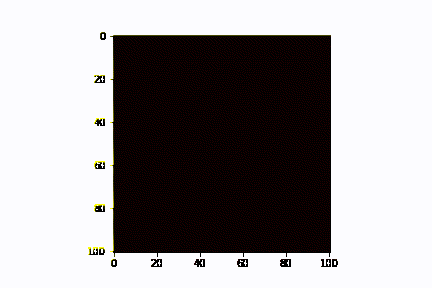

In [13]:
from IPython.display import Image
with open('wave2d_pml2.gif','rb') as file:
    display(Image(file.read()))

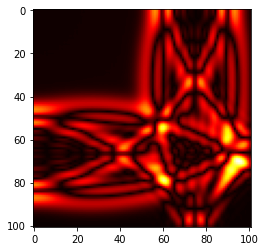

In [48]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

Nx = 101
Ny = 101
Ez = np.zeros((Nx, Ny))
Dz = np.zeros((Nx, Ny))
Hy = np.zeros((Nx, Ny))
Hx = np.zeros((Nx, Ny))
CEx = np.zeros((Nx, Ny))
CEy = np.zeros((Nx, Ny))
CHz = np.zeros((Nx, Ny))

# Coeffs
dt = 1.6678e-10
c0 = 299792458
dx = dt * c0 * 2
dy = dt * c0 * 2

# COMPUTE UPDATE COEFFICIENTS
URxx = np.ones((Nx, Ny))
URyy = np.ones((Nx, Ny))
ERzz = np.ones((Nx, Ny))

b = - c0 * dt / URxx 

a = - c0 * dt / URyy 

c = c0 * dt 

# SOURCE
Nt = 300
tt = np.array(range(Nt))
tau = 6
gEz = np.exp(- ((tt - 50)/tau)**2)

xsrc = int(np.ceil(Nx / 3))
ysrc = int(np.ceil(Ny / 4))

# FIGURE
fig = plt.figure()
ax = fig.add_subplot(111)
plts = []



# MAIN LOOP
for nt in range(Nt):
    # COMPUTE CURL PART OF +EZ/dy
    for nx in range(Nx):
        for ny in range(Ny - 1):
            CEx[nx][ny] = (Ez[nx][ny + 1] - Ez[nx][ny]) / dy
        CEx[nx][Ny - 1] = (0.0 - Ez[nx][Ny - 1]) / dy
        
    # COMPUTE CURLD PART OF -EZ/dx
    for ny in range(Ny):
        for nx in range(Nx - 1):
            CEy[nx][ny] = -(Ez[nx + 1][ny] - Ez[nx][ny]) / dx
        CEy[Nx - 1][ny] = -(0.0 - Ez[Nx - 1][ny]) / dx

    # UPDATE Hx/Hy FIELDS
    Hx = Hx + b * CEx
    Hy = Hy + a * CEy 
    
    # COMPUTE CURL PART Hy/dx - Hx/dy
    CHz[0][0] = ((Hy[0][0] - 0.0) / dx 
              -  (Hx[0][0] - 0.0) / dy)
    for nx in range(1, Nx):
        CHz[nx][0] = ((Hy[nx][0] - Hy[nx - 1][0]) / dx 
                   -  (Hx[nx][0] - 0.0) / dy)

    for ny in range(1, Ny):
        CHz[0][ny] = ((Hy[0][ny] - 0.0) / dx 
                   -  (Hx[0][ny] - Hx[0][ny - 1]) / dy)
        for nx in range(1, Nx):
            CHz[nx][ny] = ((Hy[nx][ny] - Hy[nx - 1][ny]) / dx 
                        -  (Hx[nx][ny] - Hx[nx][ny - 1]) / dy)
    # UPDATE D FIELD
    Dz = Dz + c * CHz 
    # ADD GAUSSIAN SOURCE
    Dz[xsrc][ysrc] = Dz[xsrc][ysrc] + gEz[nt]
    # UPDATE Ez FIELD
    Ez = (1. / ERzz) * Dz
    # PLOT
    Ezmax = max(max(map(max, abs(Ez))), 0.01)
    p = plt.imshow(abs(Ez), cmap = 'hot', vmax = Ezmax)
    plts.append([p])
    

from matplotlib import animation
ani = animation.ArtistAnimation(fig, plts, interval = 50, repeat_delay = 3000)
ani.save('wave2d_no_pml.gif', writer='ffmpeg')
plt.show()

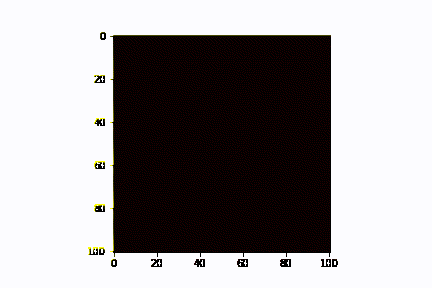

In [49]:
from IPython.display import Image
with open('wave2d_no_pml.gif','rb') as file:
    display(Image(file.read()))

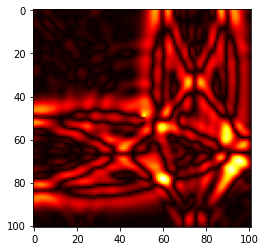

In [56]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

Nx = 101
Ny = 101
Ez = np.zeros((Nx, Ny))
Hy = np.zeros((Nx, Ny))
Hx = np.zeros((Nx, Ny))
CEx = np.zeros((Nx, Ny))
CEy = np.zeros((Nx, Ny))
CHz = np.zeros((Nx, Ny))

# Coeffs
dt = 1.6678e-10
c0 = 299792458
dx = dt * c0 * 2
dy = dt * c0 * 2

# COMPUTE UPDATE COEFFICIENTS
URxx = np.ones((Nx, Ny))
URyy = np.ones((Nx, Ny))
ERzz = np.ones((Nx, Ny))

# ADD OBSTACLE
obs_x = Nx // 2
obs_y = Ny // 2
for i in range(-1, 2, 1):
    for j in range(-1, 2, 1):
        URxx[obs_x + i, obs_y + j] = 5.0
        URyy[obs_x + i, obs_y + j] = 5.0


b = - c0 * dt / URxx 

a = - c0 * dt / URyy 

c = c0 * dt / ERzz



# FIGURE
fig = plt.figure()
ax = fig.add_subplot(111)
plts = []

# SOURCE
Nt = 300

tt = np.array(range(Nt))
tau = 6
gEz = np.exp(- ((tt - 50)/tau)**2)
xsrc = int(np.ceil(Nx / 3))
ysrc = int(np.ceil(Ny / 4))

# MAIN LOOP
for nt in range(Nt):
    # COMPUTE CURL PART OF +EZ/dy
    for nx in range(Nx):
        for ny in range(Ny - 1):
            CEx[nx][ny] = (Ez[nx][ny + 1] - Ez[nx][ny]) / dy
        CEx[nx][Ny - 1] = (0.0 - Ez[nx][Ny - 1]) / dy
        
    # COMPUTE CURLD PART OF -EZ/dx
    for ny in range(Ny):
        for nx in range(Nx - 1):
            CEy[nx][ny] = -(Ez[nx + 1][ny] - Ez[nx][ny]) / dx
        CEy[Nx - 1][ny] = -(0.0 - Ez[Nx - 1][ny]) / dx

    # UPDATE Hx/Hy FIELDS
    Hx = Hx + b * CEx
    Hy = Hy + a * CEy 
    
    # COMPUTE CURL PART Hy/dx - Hx/dy
    CHz[0][0] = ((Hy[0][0] - 0.0) / dx 
              -  (Hx[0][0] - 0.0) / dy)
    for nx in range(1, Nx):
        CHz[nx][0] = ((Hy[nx][0] - Hy[nx - 1][0]) / dx 
                   -  (Hx[nx][0] - 0.0) / dy)

    for ny in range(1, Ny):
        CHz[0][ny] = ((Hy[0][ny] - 0.0) / dx 
                   -  (Hx[0][ny] - Hx[0][ny - 1]) / dy)
        for nx in range(1, Nx):
            CHz[nx][ny] = ((Hy[nx][ny] - Hy[nx - 1][ny]) / dx 
                        -  (Hx[nx][ny] - Hx[nx][ny - 1]) / dy)
    # UPDATE Ez FIELD
    Ez = Ez + c * CHz 
    
    # ADD GAUSSIAN SOURCE
    Ez[xsrc][ysrc] = Ez[xsrc][ysrc] + gEz[nt]
    
    # PLOT
    Ezmax = max(max(map(max, abs(Ez))), 0.01)
    p = plt.imshow(abs(Ez), cmap = 'hot', vmax = Ezmax)
    plts.append([p])
    

from matplotlib import animation
ani = animation.ArtistAnimation(fig, plts, interval = 50, repeat_delay = 3000)
ani.save('wave2d_no_pml_obs.gif', writer='ffmpeg')
plt.show()

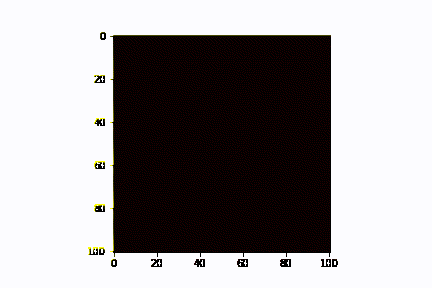

In [57]:
from IPython.display import Image
with open('wave2d_no_pml_obs.gif','rb') as file:
    display(Image(file.read()))

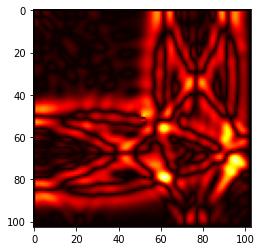

In [64]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

Nx = 103
Ny = 103
Ez = np.zeros((Nx, Ny))
Hy = np.zeros((Nx, Ny))
Hx = np.zeros((Nx, Ny))
CEx = np.zeros((Nx, Ny))
CEy = np.zeros((Nx, Ny))
CHz = np.zeros((Nx, Ny))

# Coeffs
dt = 1.6678e-10
c0 = 299792458
dx = dt * c0 * 2
dy = dt * c0 * 2

# COMPUTE UPDATE COEFFICIENTS
URxx = np.ones((Nx, Ny))
URyy = np.ones((Nx, Ny))
ERzz = np.ones((Nx, Ny))

# ADD OBSTACLE
obs_x = Nx // 2
obs_y = Ny // 2
for i in range(-1, 2, 1):
    for j in range(-1, 2, 1):
        URxx[obs_x + i, obs_y + j] = 5.0
        URyy[obs_x + i, obs_y + j] = 5.0


b = - c0 * dt / URxx 

a = - c0 * dt / URyy 

c = c0 * dt / ERzz



# FIGURE
fig = plt.figure()
ax = fig.add_subplot(111)
plts = []

# SOURCE
Nt = 300

tt = np.array(range(Nt))
tau = 6
gEz = np.exp(- ((tt - 50)/tau)**2)
xsrc = int(np.ceil(Nx / 3))
ysrc = int(np.ceil(Ny / 4))

# MAIN LOOP
for nt in range(Nt):
    # COMPUTE CURL PART OF +EZ/dy and -EZ/dx
    for nx in range(1, Nx - 1):
        for ny in range(1, Ny - 1):
            CEx[nx][ny] = (Ez[nx][ny + 1] - Ez[nx][ny]) / dy
            CEy[nx][ny] = -(Ez[nx + 1][ny] - Ez[nx][ny]) / dx

    # UPDATE Hx/Hy FIELDS
    Hx = Hx + b * CEx
    Hy = Hy + a * CEy 
    
    # COMPUTE CURL PART Hy/dx - Hx/dy
    for ny in range(1, Ny - 1):
        for nx in range(1, Nx - 1):
            CHz[nx][ny] = ((Hy[nx][ny] - Hy[nx - 1][ny]) / dx 
                        -  (Hx[nx][ny] - Hx[nx][ny - 1]) / dy)
    # UPDATE Ez FIELD
    Ez = Ez + c * CHz 
    
    # ADD GAUSSIAN SOURCE
    Ez[xsrc][ysrc] = Ez[xsrc][ysrc] + gEz[nt]
    
    # PLOT
    Ezmax = max(max(map(max, abs(Ez))), 0.01)
    p = plt.imshow(abs(Ez), cmap = 'hot', vmax = Ezmax)
    plts.append([p])
    

from matplotlib import animation
ani = animation.ArtistAnimation(fig, plts, interval = 50, repeat_delay = 3000)
ani.save('wave2d_no_pml_obs.gif', writer='ffmpeg')
plt.show()

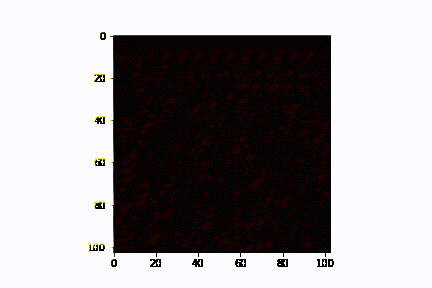

In [65]:
from IPython.display import Image
with open('wave2d_no_pml_obs.gif','rb') as file:
    display(Image(file.read()))